In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2SAVE = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/Stromal"
)
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal.h5ad")
)

In [5]:
adata

AnnData object with n_obs × n_vars = 6627 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels'
    var: 'n_cells_by_counts-Che', 'total_counts-Che', 'mean_counts-Che', 'pct_dropout_by_counts-Che', 'n_cells_by_counts-KUL', 'total_counts-KUL', 'mean_counts-KUL', 'pct_dropout_by_counts-KUL', 'n_cells_by_counts-Pelka', 'total_counts-Pelka', 'mean_counts-Pelka', 'pct_dropout_by_counts-Pelka', 'n_cells_by_counts-SMC', 'total_counts-SMC', 'mean_counts-SMC', 'pct_dropout_by_counts-SMC', 'n_cells_by_counts-Wu', 'total_counts-Wu', 'mean_counts-Wu', 'pct_dropout_by_counts-Wu', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Cell_type_colors', 'Therapy_colors', 'Tissue_colors', '_scvi_manag

### Leiden clustering

In [6]:
adata.uns["neighbors"]

OverloadedDict, wrapping:
	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 15, 'n_pcs': 10, 'random_state': 7, 'use_rep': 'X_scVI'}}
With overloaded keys:
	['connectivities', 'distances'].

In [7]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI", resolution=1, random_state=7)

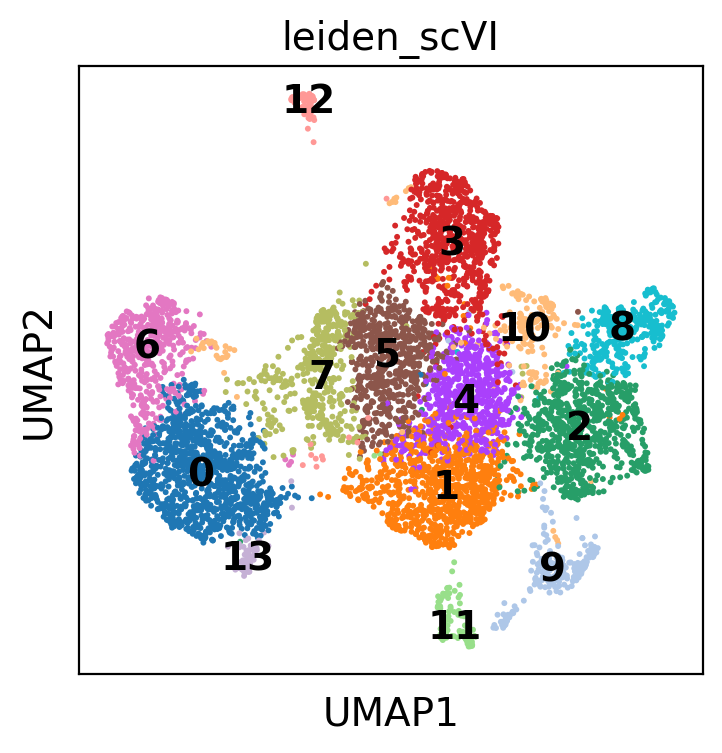

In [8]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    legend_loc="on data",
    save="general_clustering.pdf",
    show=True,
)

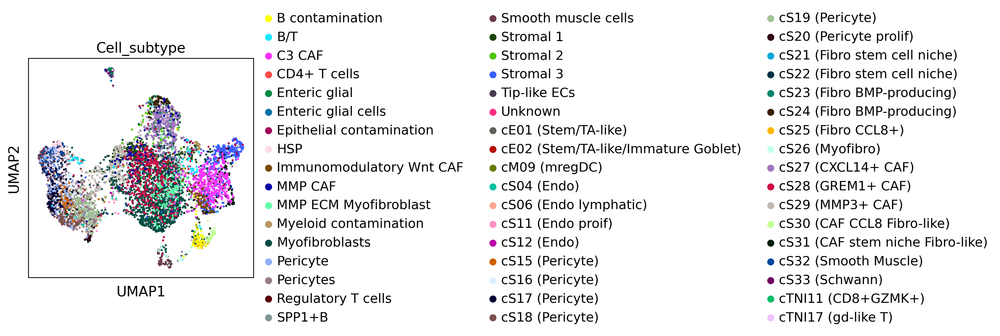

In [9]:
sc.pl.umap(adata, color="Cell_subtype", legend_loc="right margin", show=True)

In [10]:
# load cell cycle scores saved from integration
cell_cycle_scores = pd.read_csv(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/data_integration/SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_cc_scores.txt",
    sep="\t",
    index_col=0,
)

In [11]:
adata.obs = adata.obs.merge(
    cell_cycle_scores, how="left", left_index=True, right_index=True
)

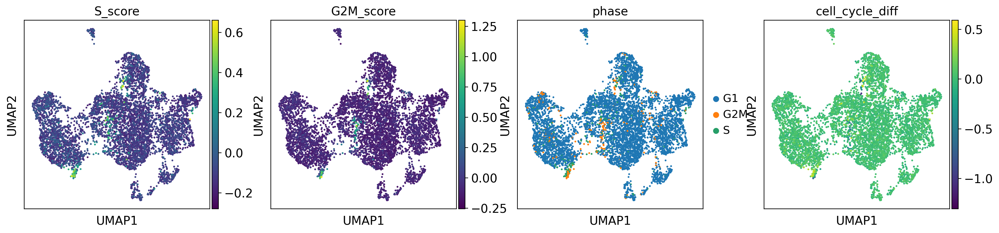

In [12]:
sc.pl.umap(
    adata,
    color=["S_score", "G2M_score", "phase", "cell_cycle_diff"],
    color_map="viridis",
    save="cell_cycle.pdf",
)

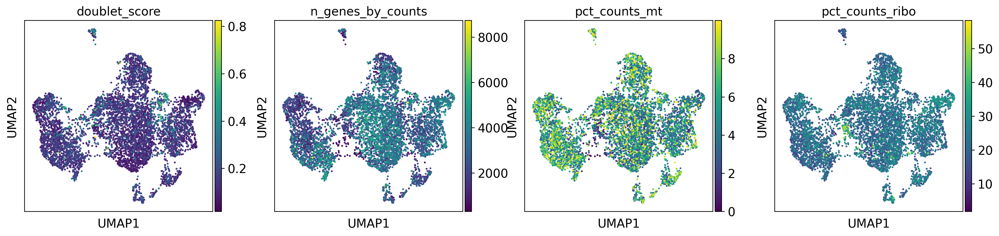

In [13]:
sc.pl.umap(
    adata,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

### Look at distribution of cell source across clusters 

In [4]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, colors: dict, figname: str
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        sharey=False,
        sharex=False,
        dpi=DPI,
    )  # figsize=(4, 4))

    print(table2plot)
    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())
    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]
    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(FIG2SAVE.joinpath(figname), dpi=DPI, format="pdf", bbox_inches="tight")
    plt.show()

cell_source        SMC        KUL      Pelka        Che
leiden_scVI                                            
0            28.797763  15.284250  51.630941   4.287046
1            27.522936  51.376147  13.302752   7.798165
2             5.866667  20.133333  13.600000  60.400000
3            26.458616   9.905020  57.530529   6.105834
4            54.531722  10.574018  19.335347  15.558912
5            42.563291  13.291139  36.075949   8.069620
6            16.935484  24.395161  35.483871  23.185484
7            16.826923  29.086538  50.961538   3.125000
8            29.881657  50.000000   6.804734  13.313609
9            13.888889   8.796296  51.851852  25.462963
10           25.668449  11.229947  16.577540  46.524064
11           47.000000  35.000000  17.000000   1.000000
12           27.272727  28.409091  29.545455  14.772727
13           33.333333  10.000000  55.000000   1.666667


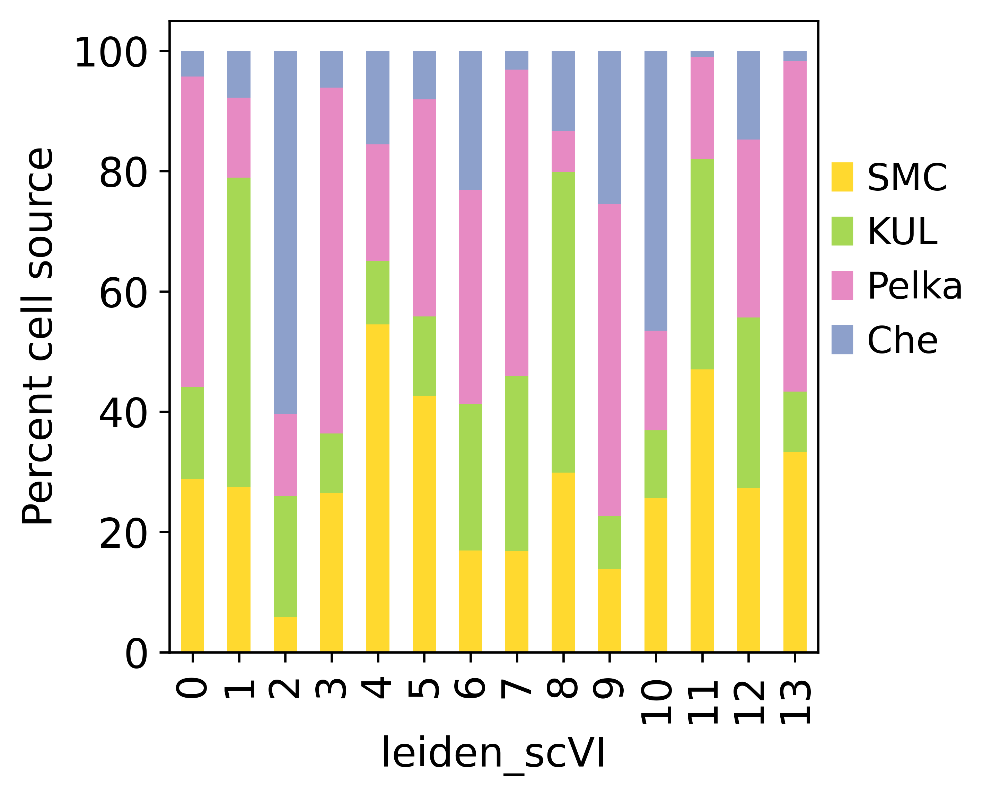

In [15]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["cell_source"].cat.categories.values.tolist(),
        adata.uns["cell_source_colors"],
    )
)

proportion_cells_patient(
    adata.obs,
    groupby_labels=["leiden_scVI", "cell_source"],
    xlabel="leiden_scVI",
    ylabel="Percent cell source",
    colors=color_dict,
    figname="leiden_cell_source.pdf",
)

leiden_scVI          0          1          2          3          4          5  \
cell_source                                                                     
SMC          16.775244  13.029316   2.388708  10.586319  19.598263  14.603692   
KUL          10.882548  29.727936  10.019907   4.844061   4.644990   5.573988   
Pelka        25.389551   5.316224   4.674610  19.431714   5.866178  10.449129   
Che           4.197080   6.204380  41.332117   4.105839   9.397810   4.653285   

leiden_scVI          6         7          8         9        10        11  \
cell_source                                                                 
SMC           4.560261  3.800217   5.483170  1.628664  2.605863  2.551574   
KUL           8.029197  8.029197  11.214333  1.260783  1.393497  2.322495   
Pelka         8.065995  9.715857   1.054079  5.132906  1.420715  0.779102   
Che          10.492701  1.186131   4.105839  5.018248  7.937956  0.091241   

leiden_scVI        12        13  
cell_source     

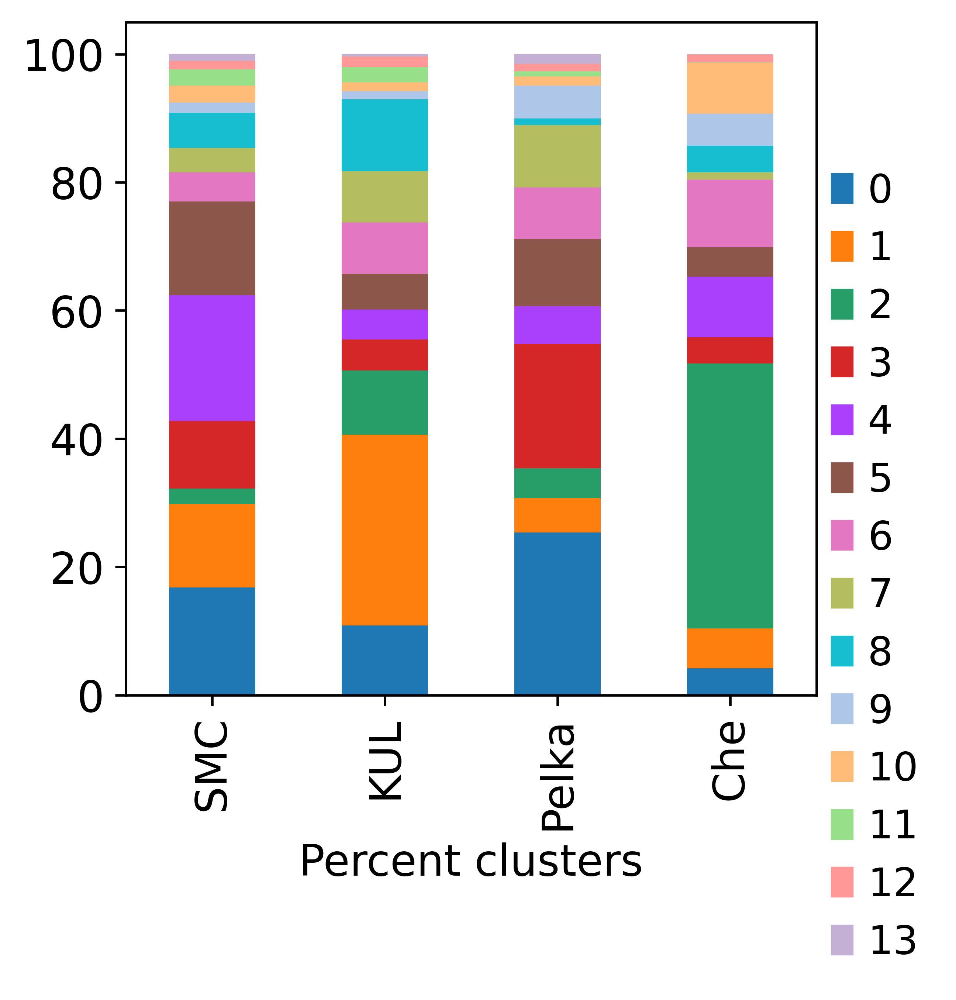

In [6]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["leiden_scVI"].cat.categories.values.tolist(),
        adata.uns["leiden_scVI_colors"],
    )
)

proportion_cells_patient(
    adata.obs,
    groupby_labels=["cell_source", "leiden_scVI"],
    xlabel="Percent clusters",
    ylabel="",
    colors=color_dict,
    figname="cell_source_clusters.pdf",
)

In [7]:
FIG2SAVE

PosixPath('/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/Stromal/figures')

### Plot some markers 

In [7]:
markers = {
    "Enteric glial": ["S100B", "PLP1"],
    # Pericytes were characterized by the coexpression of contractile genes (TAGLN, ACTA2) and RGS5
    # https://panglaodb.se/markers.html?cell_type=%27Pericytes%27
    "Pericyte": ["PDGFRB", "RGS5", "TAGLN", "ACTA2", "ABCC9"],
    # vascular smooth mus- cle cells by contractile and cytoskeletal gene expression
    "SMC": ["TAGLN", "ACTA2", "MYH11", "DES"],  # smooth muscle cell
    "Myofibro": ["TAGLN", "ACTA2", "COL1A1"],
    "Fibro": ["COL3A1", "DCN", "THY1", "SRPX", "C7"],
    "CAF": [
        "FAP",
        "PDPN",
    ],  # inflammaory C3, CD34, cytokines CXCL12, ..vs non-inflammatory , MMP , ECM matrix proteins (ECM markers), BMP
    "BMP Fibro": ["BMP2", "BMP4", "BMP5"],
    "CCL8 Fibro": ["CCL8"],
    "MMP CAF": ["MMP3", "MMP1", "CXCL8", "FTH1"],
    "C3 CAF": ["C3", "IL1RL1", "CXCL14"],
    "immunomod": ["RSPO3", "GREM1", "C3", "SFRP2", "FBLN1", "CXCL12"],
    "BMP CAF": ["CXCL14", "PDGFRA", "BMP4", "BMP5", "BMP1", "FRZB", "WNT5A", "WNT2"],
}

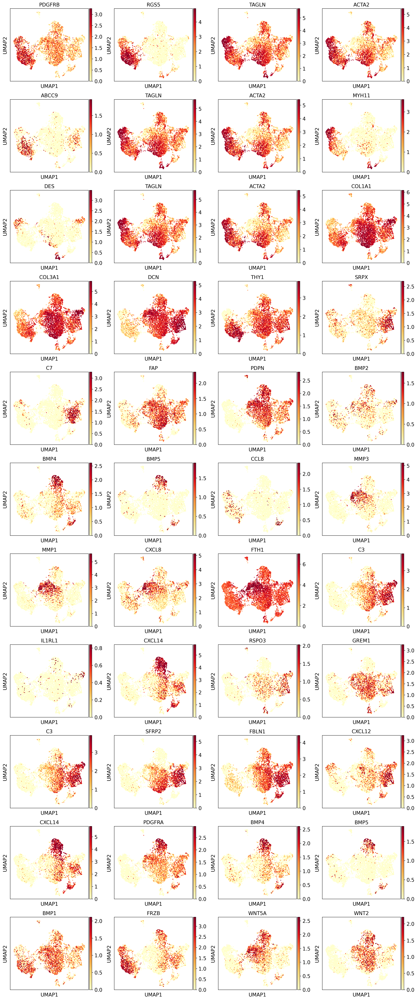

In [19]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="YlOrRd",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

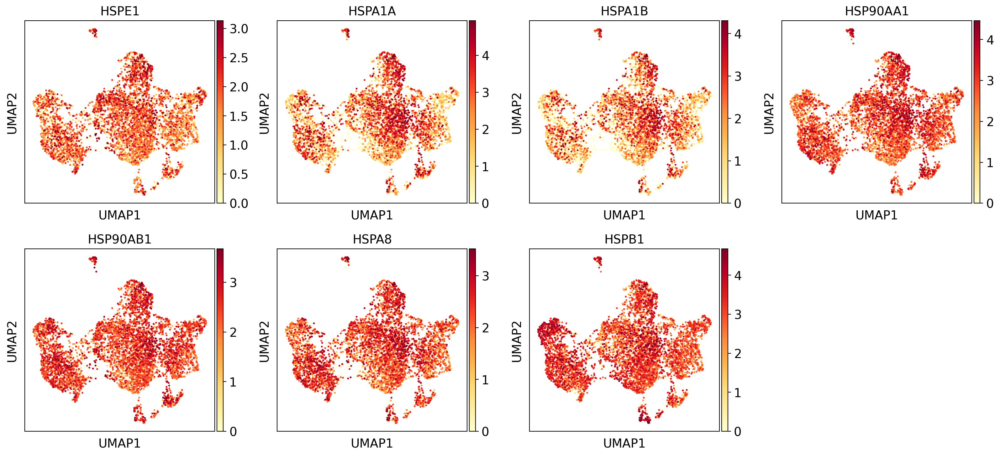

In [20]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="YlOrRd",
    save="general_HSPmarkers.pdf",
    show=True,
)

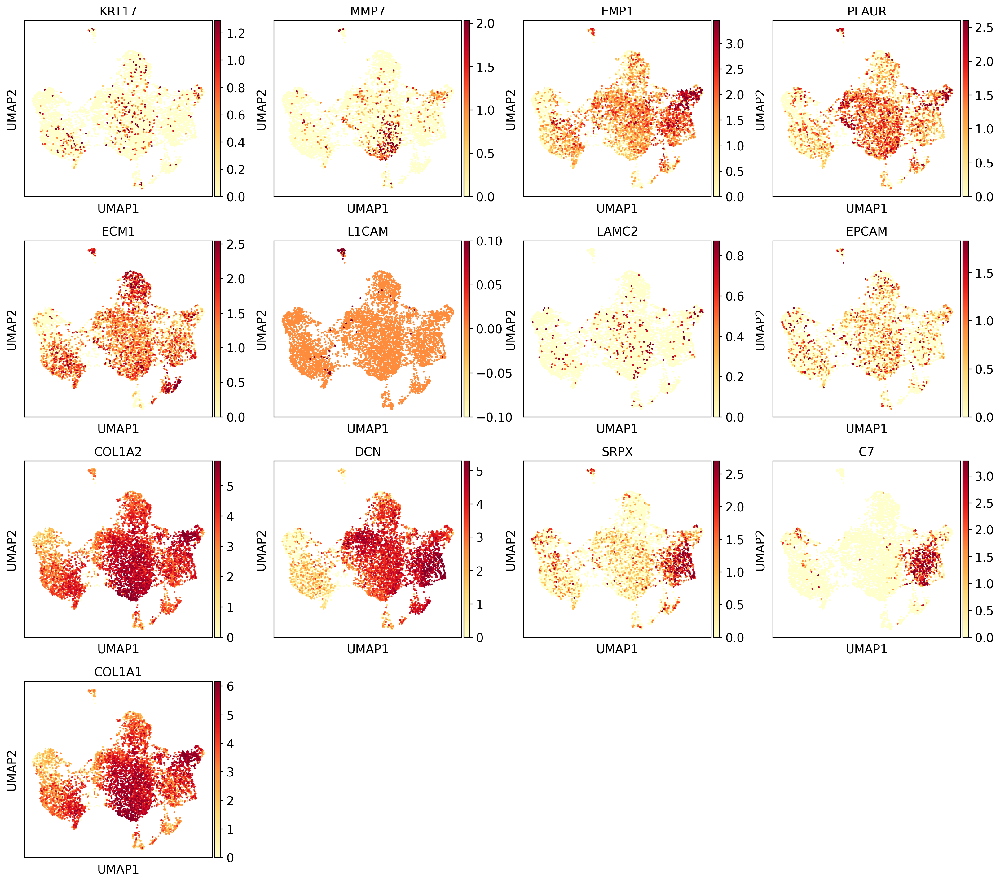

In [32]:
markers2plot = [
    "KRT17",
    "MMP7",
    "EMP1",
    "PLAUR",
    "ECM1",
    "L1CAM",
    "LAMC2",
    "EPCAM",
    "COL1A2",
    "DCN",
    "SRPX",
    "C7",
    "COL1A1",
]

sc.pl.umap(
    adata,
    color=markers2plot,
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="YlOrRd",
    save="CAF_EMTmarkers.pdf",
    show=True,
)

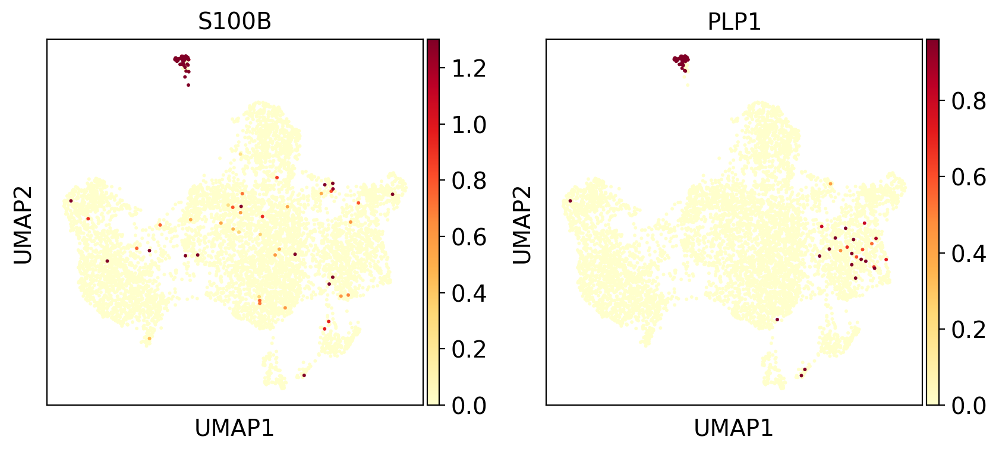

In [13]:
markers2plot = ["S100B", "PLP1"]

sc.pl.umap(
    adata,
    color=markers2plot,
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="YlOrRd",
    save="enteric_glials.pdf",
    show=True,
)

### Differential expression to get DE genes upregulated per cluster 

In [21]:
# issue here https://github.com/theislab/single-cell-tutorial/issues/97
# This seems to be a scanpy bug as you can see here and here. The latter issue suggests to just add the line:
# adata.uns['log1p']["base"] = None after reading again, or downgrading to AnnData<0.8.
# Either way, this should be fixed soon by the maintenance team.
adata.uns["log1p"]["base"] = None

In [22]:
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    reference="rest",
    method="wilcoxon",
    use_raw=True,
    layer=None,
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon",
)

categories: 0, 1, 2, etc.
var_group_labels: Enteric glial, Pericyte, SMC, etc.


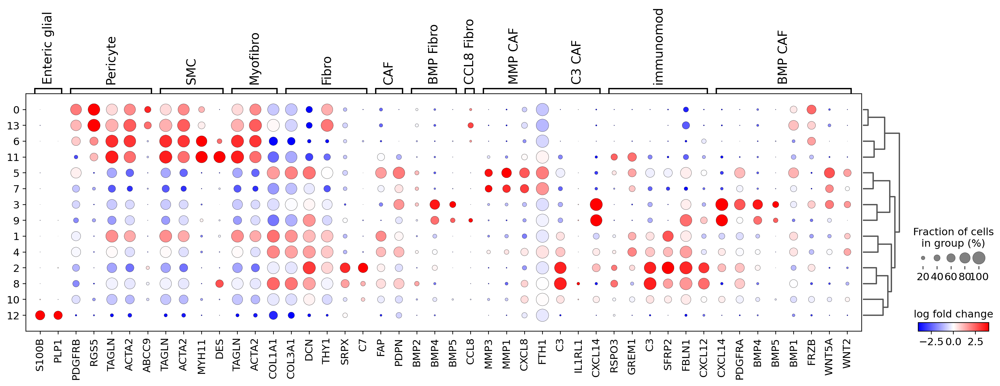

In [9]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="general_dotplot.pdf",
    show=True,
)

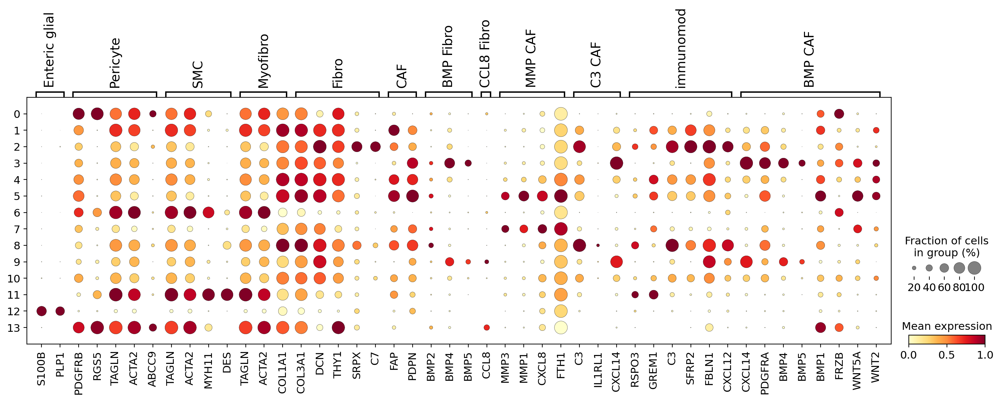

In [8]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers,
    cmap="YlOrRd",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="Stromal_dotplot_mean_general.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: shock protein, immediate early genes


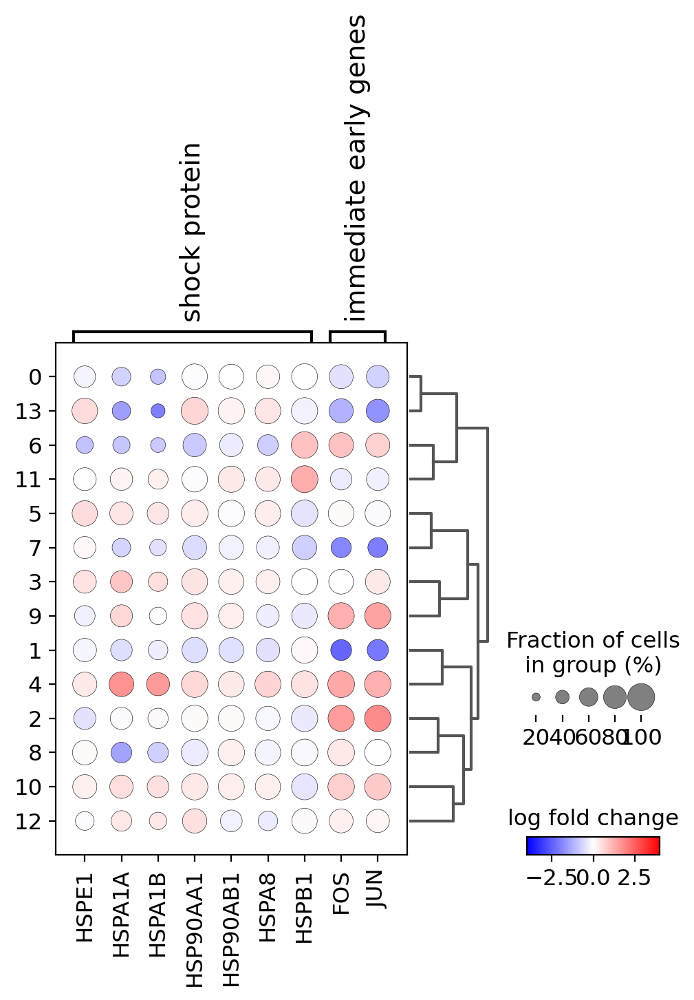

In [30]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=dissocation_markers_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="HSP_dotplot.pdf",
    show=True,
)

In [26]:
pval_thresh = 0.05
log2fc_thresh = 1
cluster_de_genes = dict()
for cluster in sorted(set(adata.obs["leiden_scVI"])):
    cluster_de_genes[cluster] = sc.get.rank_genes_groups_df(
        adata,
        group=cluster,
        key="rank_genes_wilcoxon",
        pval_cutoff=pval_thresh,
        log2fc_min=log2fc_thresh,
        log2fc_max=None,
    ).sort_values("logfoldchanges", ascending=False)

# write to excel file DE genes per cluster
# Create a Pandas Excel writer using XlsxWriter as the engine.
path2save = DIR2SAVE.joinpath(
    "Stromal_pval{}_log2fc{}.xlsx".format(pval_thresh, log2fc_thresh)
)

with pd.ExcelWriter(path2save) as writer:
    for cluster in list(cluster_de_genes.keys()):

        # get celltype of cluster
        # celltype = np.unique(adata[adata.obs['leiden']==cluster,:].obs['cell identity'])[0]

        cluster_de_genes[cluster].to_excel(
            writer, sheet_name="cluster{}".format(cluster)
        )

In [27]:
# save intermediate result
# write to file
adata.write(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

In [48]:
adata[adata.obs["leiden_scVI"] == "4"].obs.Cell_subtype.value_counts()

Myofibroblasts              422
cS28 (GREM1+ CAF)            94
MMP ECM Myofibroblast        68
cS27 (CXCL14+ CAF)           34
C3 CAF                       14
HSP                           8
Immunomodulatory Wnt CAF      8
Stromal 1                     4
Epithelial contamination      2
MMP CAF                       2
Stromal 2                     2
Stromal 3                     2
B contamination               1
Pericytes                     1
Name: Cell_subtype, dtype: int64

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

In [6]:
adata.uns["log1p"]["base"] = None

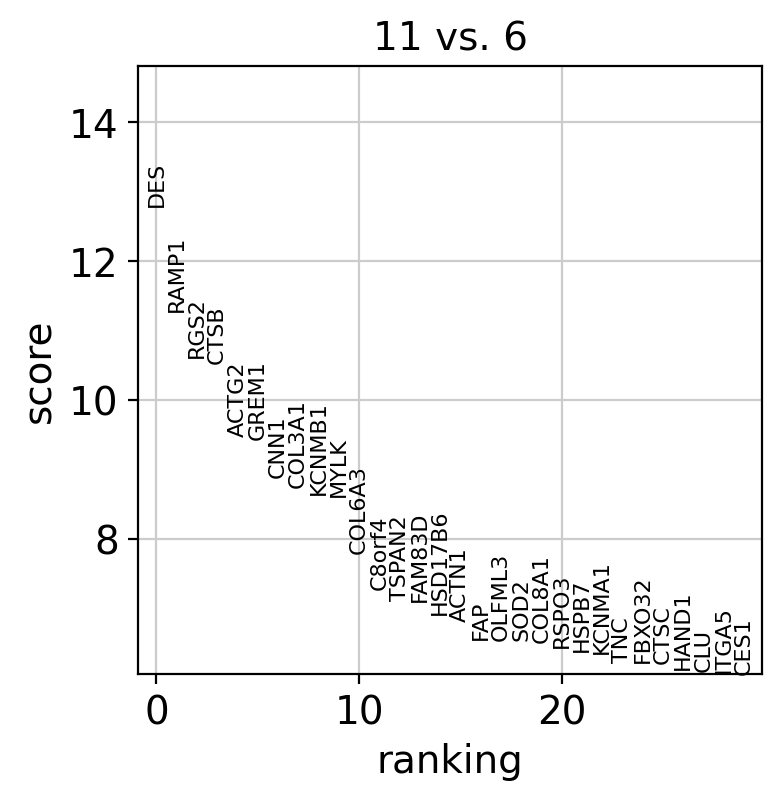

In [7]:
### Compare DE genes
# DE genes between Therapy treated vs None for C1QC TAMs
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    groups=["11"],
    reference="6",
    method="wilcoxon",
    layer="log1p",
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon_11",
    use_raw=False,
)

sc.pl.rank_genes_groups(adata, groups=["11"], n_genes=30, key="rank_genes_wilcoxon_11")

### Annotations 

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

In [5]:
old_to_new = {
    "0": "Pericyte",
    "1": "Myofibroblast",
    "2": "C3 iCAF",
    "3": "CXCL14 BMP CAF",  # TGFBR2, PDGFRA, C2, CSF1, immunomodulatory + differentiation of stem cells
    "4": "GREM1 HSP CAF",  # crypt bottom fibroblasts?
    "5": "MMP CAF",  # https://www.spandidos-publications.com/10.3892/mmr.2017.8320 BAMBI regulate migration and differentiation of macrophages in gliomas
    "6": "SMC",
    "7": "Myeloid doublet",
    "8": "Epithelial KRT19",
    "9": "B contamination",  # IGHA1, IGHA2
    "10": "T cell doublet",
    "11": "SMC-doublet",  # Only comes from SMC, could be doublet or due to
    "12": "Enteric glial",
    "13": "Stromal cycling",
}

* 0 is pericyte because RGS5, PDGFRB,  ACTA2, ABCC9
* 1 is myelofibroblast because COL1A1, TAGLN, ACTA2 (it could be a myofibroblastic CAF because according to review it has TAGLN, TPM1, MMP11, POSTN and HOPX (Cancer-associated fibroblasts in the single-cell era)
* 2 is immunomodulatory C3 CAF because **C3**, **CD34**, SFRP1, SFRP2, FBLN1, **CXCL12**, FBLN5, TGFBR3, IL11RA, RSPO3, LUM, FOXP2, mmune-modulatory cytokines and complement regulation: complement factors such as **C3**, **CFB** 
and serpin family G member 1 (**SERPING1**)
* 3 is CXCL14 BMP because CXCL14, BMP5, WNT4, WNT5B, BMP4, BMP7, PDGFRA, RAMP3, WNT5A, WNT2B, ECM1: # TGFBR2, PDGFRA, C2, CSF1, immunomodulatory + differentiation of stem cells 
* 4 is GREM1 HSP because HSP, GREM1, POSTN, MMP3, MMP11, SFRP4, FBLN1, VCAN, CXCL2, PDGFC, JUN, FOS, FAP, high levels of ECM-associated genes including collagens, POSTN, LUM, DCN, VCAN **matrix CAFs (mCAFs), expressing low levels of ACTA2 but high levels of ECM-associated genes including various collagens, POSTN, FN1, LUM, DCN and VCAN.** Crypt bottom fibroblasts, GREM1 (BMP antagonist), canonical Wnt ligands Wnt2
* 5 is MMP CAF because MMP1, CXCL5, CXCL13, CXCL6, MMP13, MMP3, MMP9, CXCL1, CXCL8, DSN, PDPN, POSTN, MMP2, FAP, COL7A1, WNT5A. It also has **BAMBI** expression which regulates migration and differentiation of macrophages in glioma, unfavourable prognostic marker in liver https://www.spandidos-publications.com/10.3892/mmr.2017.8320 . BAMBI is identified in thisTGFB pathway as a novel HIF1-regulated gene that contributes to hypoxia-induced loss of epithelial polarity. https://journals.biologists.com/jcs/article/131/10/jcs210906/56871/BAMBI-is-a-novel-HIF1-dependent-modulator-of-TGF, https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2739940/, effectors supporting invasion and metastasis metalloproteinase. BAMBI expression allows tumor cells to escape from TGF-β signaling and activate oncogenic processes such as growth stimulation, increases in motility, and invasion. Therefore, BAMBI plays an important role in the invasiveness and metastatic potential of colon cancers through cross-talk with the Wnt and TGF-β signaling pathways. + inflammatory mediators with IL6, IL11, and chemokines
* 6 is SMC because MYH11, DES, TAGLN, ACTA2
* 7 has CD68, PLAUR..
* 8 has KRT19 contamination: **Another confounding issue is the possibility of co-clustering of fibroblasts with cancer cells that have undergone EMT and therefore share mesenchymal markers --. exluced cluster containing KRT19** from CAF review paper Cancer-associated fibroblasts in the single-cell era
* 9 has PLTP, TGFB1, IL34, CXCL6, C2, TGFBR2, CCL13, CCL11, **CXCL14**, **CCL8**, APOE, CCL2, RBP1, CXCL1, **CFD**, **TGFBR2** but it has B cell contaminattion
* 10 has CD3E..
* 11 has SMC like stuff but also some collagen expression if we look at umap: SMC-like Myofibroblast
* 12 has epithelial and HLA contamination
* 14 is cycling

In [9]:
markers_specific = {
    "Enteric glial": ["S100B", "PLP1"],
    "Pericyte": ["PDGFRB", "RGS5", "TAGLN", "ACTA2", "ABCC9"],
    "SMC": ["TAGLN", "ACTA2", "MYH11", "DES"],  # smooth muscle cell
    "Myofibro": ["TAGLN", "ACTA2", "COL1A1"],
    "Fibro": ["COL3A1", "DCN", "THY1", "SRPX", "C7"],
    "CAF": ["FAP", "PDPN"],
    "C3 CD34 iCAF": [
        "C3",
        "CD34",
        "SFRP1",
        "SFRP2",
        "CXCL12",
        "FBLN5",
        "RSPO3",
    ],
    "CXCL14 BMP": ["CXCL14", "BMP4", "BMP5", "WNT4", "BMP7", "PDGFRA"],
    "GREM1": ["GREM1", "SFRP4", "VCAN"],
    "MMP": [
        "MMP3",
        "MMP1",
        "CXCL5",
        "CXCL13",
        "CXCL6",
        "MMP9",
        "MMP13",
        "CXCL1",
        "CXCL8",
        "COL7A1",
    ],
    "CCL8": ["CCL8", "TGFB1", "IL34", "C2", "CCL13", "CXCL14", "APOE", "CCL2"],
}

categories: 0, 1, 2, etc.
var_group_labels: Enteric glial, Pericyte, SMC, etc.


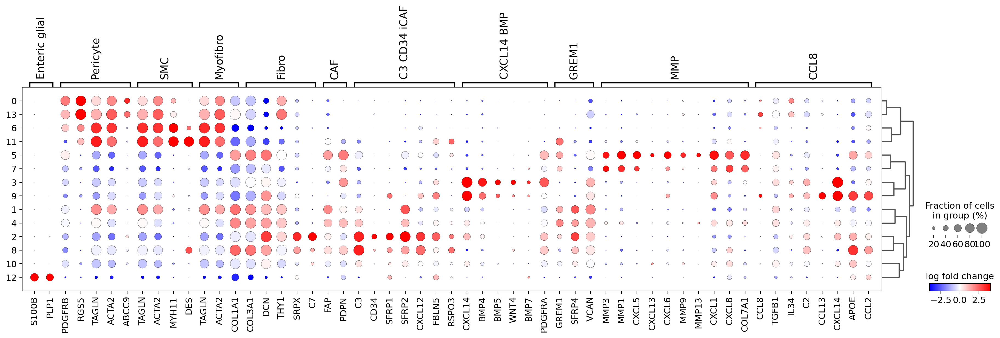

In [10]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers_specific,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="specific_dotplot.pdf",
    show=True,
)

In [11]:
adata.obs["Annotation_scVI_detailed"] = (
    adata.obs["leiden_scVI"].map(old_to_new).astype("category")
)

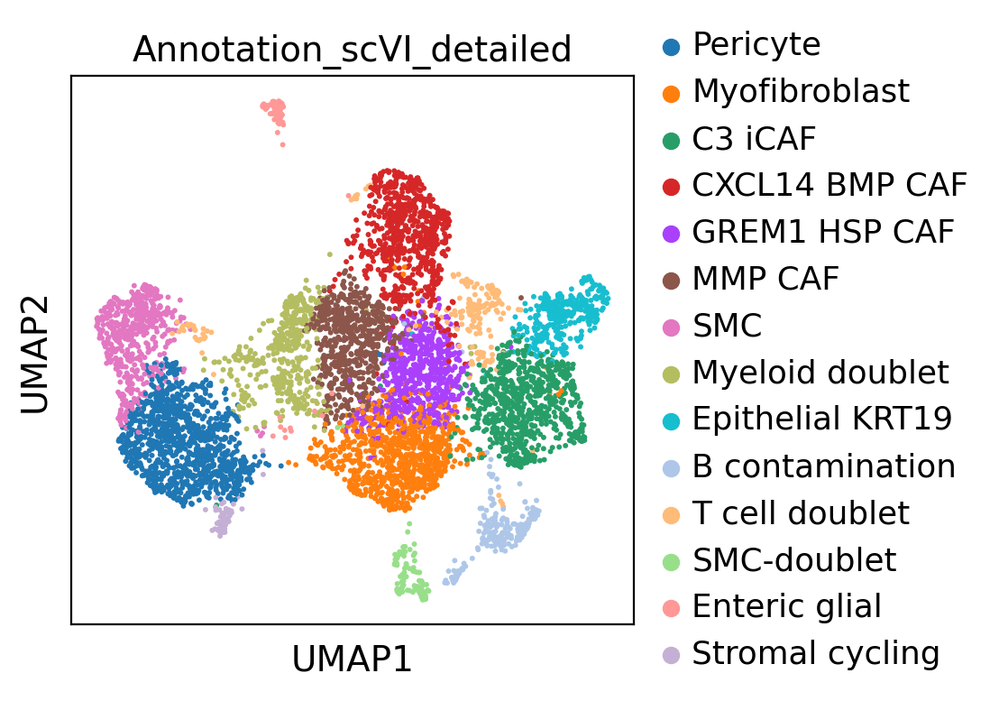

In [12]:
sc.pl.umap(
    adata, color="Annotation_scVI_detailed", show=True, legend_loc="right margin"
)

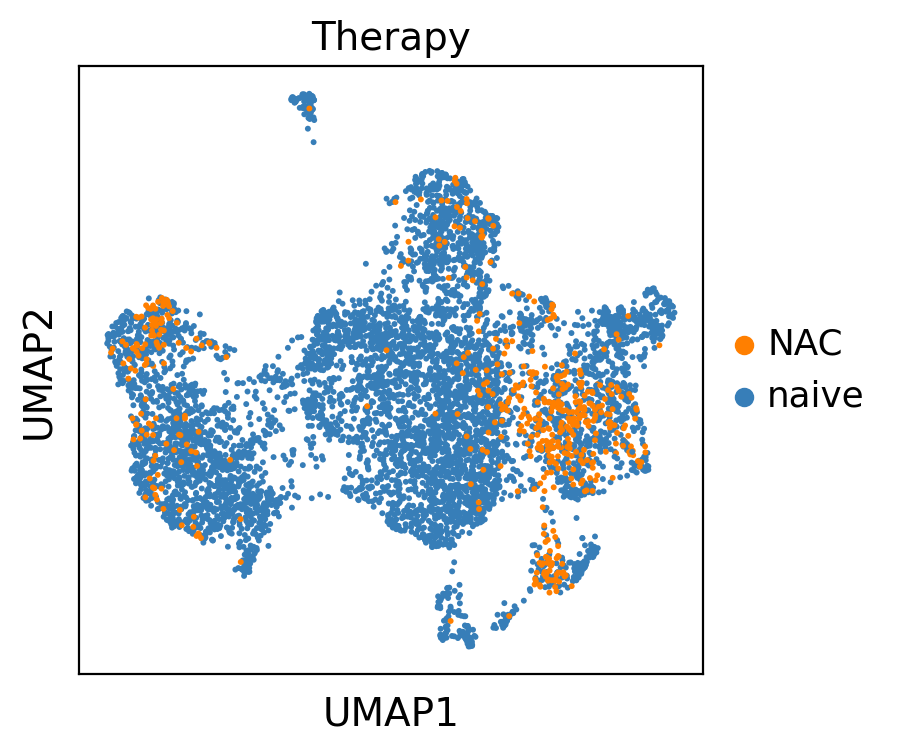

In [13]:
sc.pl.umap(adata, color="Therapy", show=True, legend_loc="right margin")

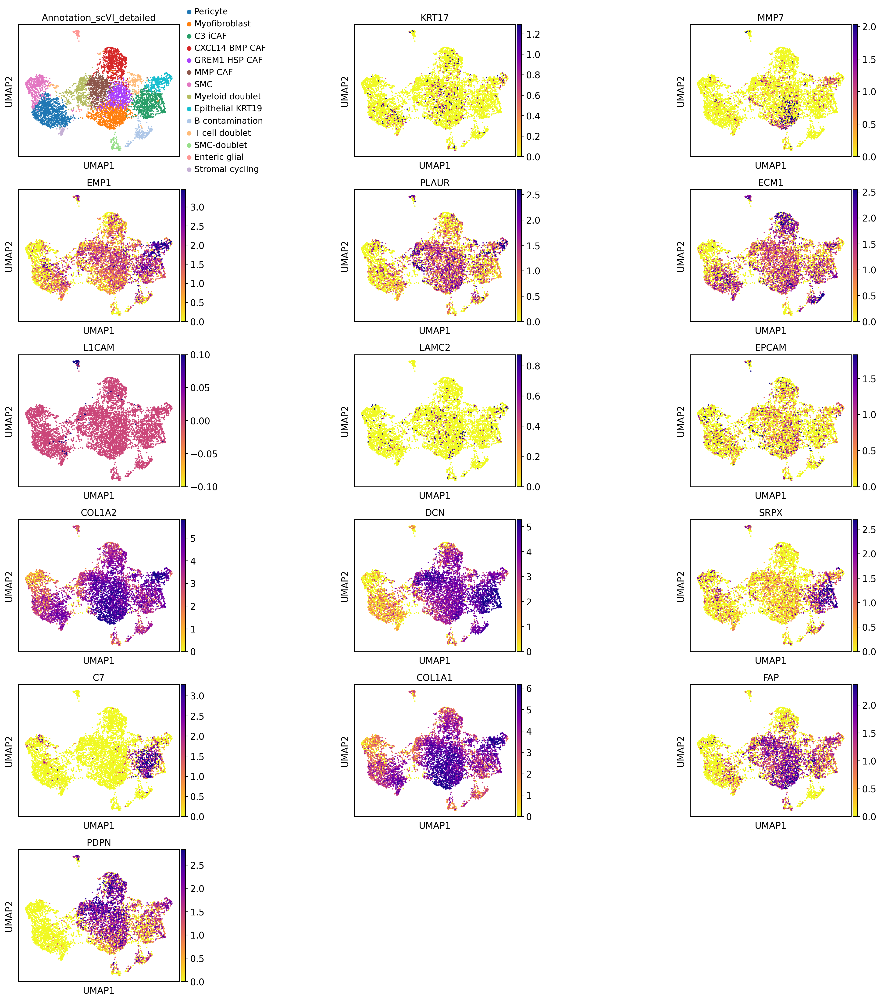

In [14]:
markers2plot = [
    "KRT17",
    "MMP7",
    "EMP1",
    "PLAUR",
    "ECM1",
    "L1CAM",
    "LAMC2",
    "EPCAM",
    "COL1A2",
    "DCN",
    "SRPX",
    "C7",
    "COL1A1",
    "FAP",
    "PDPN",
]

sc.pl.umap(
    adata,
    color=["Annotation_scVI_detailed"] + markers2plot,
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    wspace=0.9,
    ncols=3,
    save="CAF_EMTmarkers.pdf",
    show=True,
)

### Write to file

In [15]:
# write to file
adata.write(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

# write csv of annotations
adata.obs["Annotation_scVI_detailed"].to_csv(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Stromal_annotations.txt"
    ),
    sep="\t",
    index=True,
    header=True,
)